In [1]:
current_high_score = 0.8005
dataset_num = 2

In [2]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

from sklearn.ensemble import GradientBoostingClassifier

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
train = pd.read_csv(f'../../data/preproc_data/train_{dataset_num}_1.csv')
test = pd.read_csv(f'../../data/preproc_data/test_{dataset_num}_1.csv')

In [5]:
X_train = train.drop(columns=['Transported', 'PassengerId'])
y_train = pd.DataFrame(train['Transported'])

X_train.head()

,HomePlanet_Earth,HomePlanet_Europa,HomePlanet_Mars,CryoSleep_0.0,CryoSleep_1.0,Destination_55 Cancri e,Destination_PSO J318.5-22,Destination_TRAPPIST-1e,VIP_False,VIP_True,...,AgeGroup_3,AgeGroup_4,AgeGroup_5,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,GroupSize,Expenditure
0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,...,0.0,1.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,1,0.000000
1,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,4.700480,2.302585,3.258097,6.309918,3.806662,1,6.602588
2,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,1.0,3.784190,8.182280,0.000000,8.812248,3.912023,2,9.248021
3,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,...,0.0,1.0,0.0,0.000000,7.157735,5.918894,8.110728,5.267858,2,8.551981
4,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,5.717028,4.262680,5.023881,6.338594,1.098612,1,6.995766


In [6]:
X_train, X_test, y_train, y_test = train_test_split(X_train, y_train, test_size=0.2, random_state=42)
y_train = y_train.values.ravel()


X_train.shape, X_test.shape, y_train.shape, y_test.shape

((6954, 42), (1739, 42), (6954,), (1739, 1))

In [7]:
# gb_param_grid = {
#     'n_estimators': [100, 200, 300, 400, 500],
#     'learning_rate': [0.01, 0.05, 0.1, 0.2, 0.3],
#     'max_depth': [3, 4, 5, 6, 7, 8],
#     'min_samples_split': [2, 5, 10, 20],
#     'min_samples_leaf': [1, 2, 5, 10],
#     'max_features': [None, 'auto', 'sqrt', 'log2'],
#     'subsample': [0.6, 0.8, 1.0],
#     'loss': ['deviance', 'exponential']
# }

gb_param_grid = {
    'n_estimators': [150, 200, 250],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 6, 7, 8],
    'min_samples_split': np.linspace(0.1, 0.5, 12),
    'min_samples_leaf': np.linspace(0.1, 0.5, 12),
    'max_features': ['sqrt'],
    'subsample': [0.5, 0.618, 0.8, 0.85, 0.9, 0.95, 1.0],
    'loss': ['exponential']
}

gb_clf = GradientBoostingClassifier()

gb_grid_search = GridSearchCV(estimator=gb_clf, param_grid=gb_param_grid, 
                               cv=3, scoring='accuracy', verbose=2, n_jobs=-1)
gb_grid_search.fit(X_train, y_train)

gb_best_model = gb_grid_search.best_estimator_
best_params = gb_grid_search.best_params_

gb_pred = gb_best_model.predict(X_test)

ggb_accuracy = accuracy_score(y_test, gb_pred)
conf_matrix = confusion_matrix(y_test, gb_pred)
class_report = classification_report(y_test, gb_pred)


Fitting 3 folds for each of 36288 candidates, totalling 108864 fits
[CV] END learning_rate=0.01, loss=exponential, max_depth=3, max_features=sqrt, min_samples_leaf=0.1, min_samples_split=0.1, n_estimators=150, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=exponential, max_depth=3, max_features=sqrt, min_samples_leaf=0.1, min_samples_split=0.1, n_estimators=150, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=exponential, max_depth=3, max_features=sqrt, min_samples_leaf=0.1, min_samples_split=0.1, n_estimators=150, subsample=0.618; total time=   0.5s
[CV] END learning_rate=0.01, loss=exponential, max_depth=3, max_features=sqrt, min_samples_leaf=0.1, min_samples_split=0.1, n_estimators=150, subsample=0.8; total time=   0.5s
[CV] END learning_rate=0.01, loss=exponential, max_depth=3, max_features=sqrt, min_samples_leaf=0.1, min_samples_split=0.1, n_estimators=150, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=exponential, max

/root/code/BigEd12/virtual_envs/machine_learning/lib/python3.12/site-packages/numpy/ma/core.py:2846: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


In [11]:
# Display results
print(f"Best Parameters: {best_params}")
print(f"Accuracy: {ggb_accuracy:.4f}")
print("Confusion Matrix:")
print(conf_matrix)
print("Classification Report:")
print(class_report)


Best Parameters: {'learning_rate': 0.1, 'loss': 'exponential', 'max_depth': 6, 'max_features': 'sqrt', 'min_samples_leaf': np.float64(0.1), 'min_samples_split': np.float64(0.28181818181818186), 'n_estimators': 250, 'subsample': 1.0}
Accuracy: 0.7861
Confusion Matrix:
[[662 199]
 [173 705]]
Classification Report:
              precision    recall  f1-score   support

       False       0.79      0.77      0.78       861
        True       0.78      0.80      0.79       878

    accuracy                           0.79      1739
   macro avg       0.79      0.79      0.79      1739
weighted avg       0.79      0.79      0.79      1739



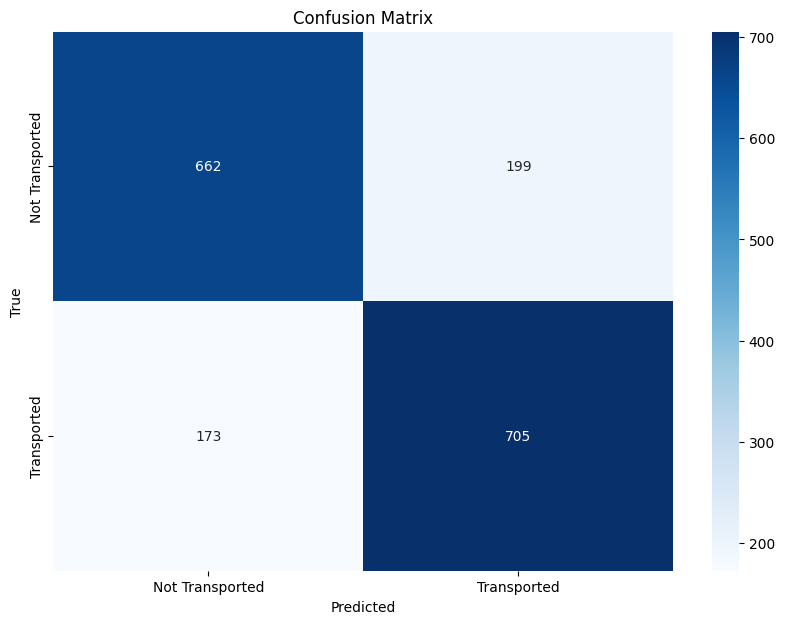

In [9]:
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Not Transported', 'Transported'], 
            yticklabels=['Not Transported', 'Transported'])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

In [10]:
test_no_id = test.copy().drop(columns='PassengerId')
predictions = gb_best_model.predict(test_no_id)

predictions_bool = predictions == 1

submission = pd.DataFrame({
    'PassengerId': test['PassengerId'],
    'Transported': predictions_bool
})

submission.to_csv(f'../../data/submissions/data_{dataset_num}/2_1/GB_train_test_data_{dataset_num}_1.csv', index=False)
display("Submission file generated successfully.")


'Submission file generated successfully.'